In [ ]:
# Examen tercer parcial 
# Andrea Mercado Jiménez

In [39]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import animation
import scipy.io
import networkx as nx
from IPython.display import HTML 

In [47]:
# Ejercicio 3: Modifique el código de animation2_2 para usar la información de 'fve30.mat'. Para las coordenadas 'x', 'y', 'z' utiliza un arreglo de números enteros aleatorios en el intevalor [0, 50]

file_path = r"C:\\Users\\andim\\OneDrive\\Escritorio\\Quinto Semestre\\Modelos Computacionales\\fve30.mat"
mat_data = scipy.io.loadmat(file_path)

mat_dict = {k: v for k, v in mat_data.items() if k[0] != '_'}
mat_dict

{'Names': array(['  V1', '  V2', '  V3', '  VP', ' V3a', '  V4', ' VOT', ' V4t',
        '  MT', ' FST', 'PITd', 'PITv', 'CITd', 'CITv', 'AITd', 'AITv',
        'STPp', 'STPa', '  TF', '  TH', 'MSTd', 'MSTl', '  PO', ' PIP',
        ' LIP', ' VIP', '  DP', '  7a', ' FEF', '  46'], dtype='<U4'),
 'CIJ': array([[0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
         1, 1, 0, 0, 0, 0, 0, 0],
        [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
         1, 1, 0, 1, 0, 0, 1, 0],
        [1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
         1, 1, 1, 1, 0, 0, 1, 0],
        [0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0,
         1, 1, 0, 1, 0, 0, 1, 0],
        [1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
         1, 0, 0, 0, 1, 0, 1, 0],
        [1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0,
         0, 1, 1, 0, 1, 0, 1, 1],
        [0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1

In [48]:
m_dict.keys()
for key in m_dict.keys():
    print(m_dict[key].shape, m_dict[key].ndim)

NameError: name 'm_dict' is not defined

In [51]:
matAdj = mat_data['CIJ']
G = nx.from_numpy_array(matAdj)

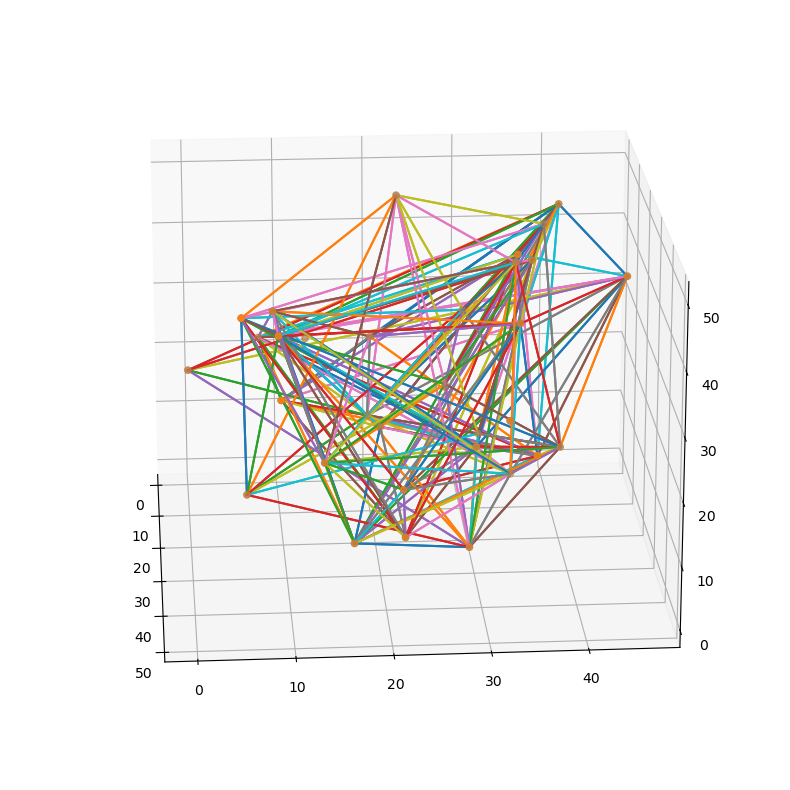

In [53]:
n_nodos = G.number_of_nodes()
x = np.random.randint(0, 51, size= 32)
y = np.random.randint(0, 51, size= 32)
z = np.random.randint(0, 51, size= 32)

# Generar arreglos: nodos y aristas
nodes = np.array([[i, j, k] for i, j, k in zip(x, y, z)])
edges = np.array([(nodes[u], nodes[v]) for u, v in G.edges()])

# Graficar
fig = plt.figure(figsize = (10, 10))
ax = fig.add_subplot(111, projection="3d")


# Iniciar
def init():
    ax.scatter(*nodes.T)
    for edge in edges:
        ax.plot(*edge.T)
    return fig,

# Animación
def animate(i):
    ax.view_init(elev= 20, azim= i*4)
    return fig,

animacion = animation.FuncAnimation(fig, animate, init_func=init, frames=90, interval=200, blit=False)

# Renderizar
HTML(animacion.to_jshtml()) 